# Application 01: Depth Blur / Portrait Mode

## 1. Introduction
In the previous notebook, we explored **monocular depth estimation** to generate depth maps at an high level. Now, here we extend that understanding to apply **depth-aware blur effects** using OpenCV.  

Depth estimation enables us to simulate how cameras perceive depth by analyzing the relative distances of objects in a scene. This allows us to create effects like:  
- **Portrait Blur** → Keeping the subject sharp while blurring the background.  
- **Selective Focus** → Emphasizing specific objects while defocusing others.  
- **Background Defocus** → Simulating a shallow depth of field as seen in professional cameras.  

---

<div style="text-align: center;">
  <figure style="display: inline-block;">
    <img src="https://learnopencv.com/wp-content/uploads/2025/01/DepthBlur-Portrait-Effect-using-DepthPro-DepthMap-Monocular-Depth-Estimation-Applications-1-1024x927.jpg" height="600" alt="Selective focus with depth">
    <figcaption style="text-align: center;">Potrait Blur with depth</figcaption>
  </figure>
</div>


### Our Approach

We integrate deep learning-based depth estimation with **OpenCV's image processing techniques** to achieve potrait blur. The process involves:  
- **Extracting depth maps** from a single RGB image using a **pretrained deep learning model (Apple Depth Pro)**.  
-  **Processing depth information** to segment the scene based on distance.  
- **Applying OpenCV-based selective blurring**, ensuring that the foreground remains sharp while background regions are blurred.  


This method is particularly useful in applications such as computational photography, augmented reality, and post-processing in photo or video editing, where precise control over focus and depth-of-field effects is required.



To get started, we will need depth maps.
You are free to use any source for obtaining depth maps, whether through a monocular depth estimator, stereo vision, or a real depth-sensing camera. As discussed in the starter, we will use Depth Pro for this module to obtain depth. Once you generate the depth map from any source, the subsequent application code should function as expected.


### Why Specifically Depth Pro?

As of Mar 2025, **Depth Pro** is a state-of-the-art (SOTA) model capable of producing high-quality depth maps with **sharp** boundaries for images. For depth applications like these, having high-resolution depth maps offers a significant advantage such as :



✅ **More accurate focus separation** between foreground and background.  
✅ **Cleaner depth transitions**, reducing artifacts in blur effects.  
✅ **Better generalization** across diverse images and scenes.  

  
---
If you would like to know more about the architectural and deep learning aspects of Depth Pro, check out our extensive article on LearnOpenCV, which motivated us to integrate this module into the course. [[Link]](https://learnopencv.com/depth-pro-monocular-metric-depth/)

## 2. Installing Dependencies

At first, we first **clone the Depth Pro repository** and set up the required dependencies.

In [ ]:
%%capture
!git clone https://github.com/apple/ml-depth-pro.git
%cd ml-depth-pro
!pip install -e .

In [ ]:
# Download the model checkpoint from huggingface
%%capture
!pip install huggingface-hub
!huggingface-cli download --local-dir checkpoints apple/DepthPro
%cd ..

In [ ]:
import os
import sys
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Add the src path for depth_pro
sys.path.append('ml-depth-pro/src')
!ln -s ml-depth-pro/checkpoints ./checkpoints # create a symbolic link to manage relative paths

os.makedirs("input_images",   exist_ok=True)
os.makedirs("raw_depth_output", exist_ok = True)
os.makedirs("depth_blur_results", exist_ok = True)

import warnings
warnings.filterwarnings('ignore')

#### Download Images

In [ ]:
!wget -q "https://learnopencv.com/wp-content/uploads/2025/03/satya-scaled.jpg" -O input_images/satya.jpg
!wget -q "https://learnopencv.com/wp-content/uploads/2025/03/captain_america-scaled.jpg" -O input_images/captain_america.jpg
!wget -q "https://www.dropbox.com/scl/fi/fgo4gg0xcvjx3nk2ma2c6/friends.jpg?rlkey=itgxvzgmbrm8igsjdg5njzv4h&st=6h3glf5h&dl=1" -O input_images/friends.jpg
!wget -q "https://www.dropbox.com/scl/fi/hc2fx7ig6kq4pr9bwvcf6/woman-valley.jpg?rlkey=zvr8zyfewr7c5xdpsfhj5jwoq&st=1e10tdio&dl=1" -O input_images/woman.jpg
!wget -q "https://www.dropbox.com/scl/fi/irgtc9racyrrbvt6mfzwz/Hemiciclo-a-Ju-rez.jpg?rlkey=2f84fwwqbkvr2w45ngni4yo3i&st=5g56221p&dl=1" -O input_images/hemiciclo-a-jurez.jpg

## 3. Depth Pro - Depth Estimation

In [ ]:
import depth_pro

# Load model and preprocessing transform
model, transform = depth_pro.create_model_and_transforms()
model.to("cuda").eval()
print("Model Loaded Successfully...✅")

Model Loaded Successfully...✅


This function processes an RGB image with Depth Pro to predict a depth map, normalizing and scaling it for visualization. It then saves the depth map as an grayscale image and returns both the raw depth and inverse depth representations for visualization using matplotlib.

In [ ]:
# Predict raw depth using Depth Pro
def predict_depth(rgb_image, output_path):

    # Load and preprocess an image.
    image, _, f_px = depth_pro.load_rgb(image_path)
    image = transform(image).to("cuda")

    # Run inference.
    prediction = model.infer(image, f_px=f_px)
    depth = prediction["depth"]  # Depth in [m].
    focallength_px = prediction["focallength_px"]  # Focal length in pixels.
    inverse_depth = 1 / depth

    # ************* Clipping and Normalization *************
    # Normalize the depth map to [0, 255]
    depth = (depth - depth.min()) / depth.max()  # Normalize to [0, 1]
    depth = depth * 255.  # Scale to [0, 255]

    # ******************************************************
    # Visualize inverse depth instead of depth, clipped to [0.1m;250m] range for better visualization.
    max_invdepth_vizu = min(inverse_depth.max(), 1 / 0.1)
    min_invdepth_vizu = max(1 / 250, inverse_depth.min())
    inverse_depth_normalized = (inverse_depth - min_invdepth_vizu) / (
        max_invdepth_vizu - min_invdepth_vizu)

    inverse_depth = inverse_depth_normalized * 255. # Scale to [0, 255]
    inverse_depth = inverse_depth.cpu().numpy()

    # ********************************************************
    # Convert depth map to a NumPy array
    depth = depth.detach().cpu().numpy().astype("uint8")


    # Save the resized depth map
    cv2.imwrite(output_path, depth)

    return depth, inverse_depth

In [ ]:
def plot(rgb_image, raw_depth, inverse_depth):

    # Create subplots (1 row, 5 columns)
    fig, ax = plt.subplots(5, 1, figsize=(10, 25))

    # Image Titles
    titles = ["RGB Image", "Raw Depth Map", "Colored Depth Map", "Inverse Depth Map", "Colored Inverse Depth Map"]
    images = [rgb_image, raw_depth, raw_depth, inverse_depth, inverse_depth]
    cmaps = [None, "gray", "inferno", "gray", "inferno"]  # Colormap settings

    for i in range(5):
        ax[i].imshow(images[i], cmap = cmaps[i])
        ax[i].axis('off')
        ax[i].set_title(titles[i])
        ax[i].set_anchor('C')

    plt.tight_layout()
    plt.show()

#### Sample 1

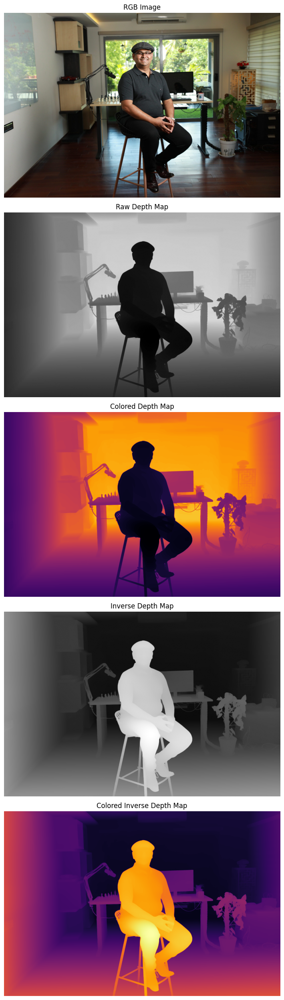

In [ ]:
image_path = "input_images/satya.jpg"
image_fname = os.path.splitext(os.path.basename(image_path))[0]
output_path = f"raw_depth_output/{image_fname}_raw_depth.png"

# Load RGB image and depth map
rgb_image = cv2.imread(image_path)[:, :, ::-1]  # Convert BGR to RGB
raw_depth = cv2.imread(output_path, cv2.IMREAD_GRAYSCALE)  # Load as grayscale depth map

raw_depth, inverse_depth = predict_depth(rgb_image, output_path)

plot(rgb_image, raw_depth, inverse_depth)

## 4. Potrait Blur with OpenCV  


This section applies a **depth-aware blur** effect using OpenCV. It selectively blurs background regions while keeping the subject in focus based on a **predicted depth map**.


Let's breakdown:


```python
def depth_blur_opencv(rgb_image, raw_depth, kernel_size=(51, 51), sharp_focus_range=0.22, manual_focus_near=None):
```


- `rgb_image` → Input RGB image.
- `raw_depth` → Grayscale depth map with depth values.
- `kernel_size` → Defines the blur strength (larger = stronger blur).
- `sharp_focus_range` → Controls how much of the image remains sharp.
- `manual_focus_near` → User-defined focus point (optional).



1. Normalize the Depth Map:
```python
depth_map_normalized = cv2.normalize(raw_depth.astype(np.float32), None, 0, 1, cv2.NORM_MINMAX)
depth_map_uint8 = (depth_map_normalized * 255).astype(np.uint8)
```

  - Converts the depth map to `float32` and normalizes it to `[0,1]`.
  - Scales it back to `0-255 (uint8)` for OpenCV operations.

2. Determine the Focus Region
```python
min_depth = np.min(depth_map_normalized)  # Minimum pixel value (closest object)
focus_margin = sharp_focus_range  # Renamed for clarity
if manual_focus_near is not None:
    focus_near = manual_focus_near  # Use user-specified focus distance
else:
    focus_near = int(min_depth * 255)
focus_far = int((min_depth + focus_margin) * 255)  # Always compute focus_far
```
  - Finds the closest object (`min_depth`).
  - Uses `manual_focus_near` if provided, otherwise computes `focus_near`.
  - Defines focus range → Objects in `[focus_near, focus_far]` remain sharp.

>For example, if `min_depth = 0.1`, `sharp_focus_margin = 0.22` :

> `focus_near = int(0.1 * 255)  # 25`

> `focus_far = int((0.1 + 0.22) * 255)  # 84 ; Focus range: [25, 84]`

3. Create a Focus Mask
```python
focus_mask = cv2.inRange(depth_map_uint8, focus_near, focus_far)
```

    Generates a binary mask:
  - White (`255`) → In-focus region (subject).
  - Black (`0`) → Background (to be blurred).


4. Apply Gaussian Blur
```python
blurred_image = cv2.GaussianBlur(rgb_image, kernel_size, 0)
```

  - Applies a soft blur across the entire image.
  - Larger `kernel_size` → stronger blur effect.

5. Blend Sharp & Blurred Images
```python
focus_mask_color = cv2.merge([focus_mask] * 3)
result = np.where(focus_mask_color == 255, rgb_image, blurred_image)
```
  - Merges the focus mask into 3 channels (BGR format).
  - Blends the images:
    - Keeps original RGB image where the mask is white.
    - Replaces background with the blurred image where the mask is black.



In [ ]:
def depth_blur_opencv(rgb_image, raw_depth, kernel_size = (51, 51), sharp_focus_range = 0.22, manual_focus_near = None):

    height, width, channel = rgb_image.shape

    # Normalize depth map to range [0, 1]
    depth_map_normalized = cv2.normalize(raw_depth.astype(np.float32), None, 0, 1, cv2.NORM_MINMAX)

    # Convert normalized depth map back to uint8 (0-255 range)
    depth_map_uint8 = (depth_map_normalized * 255).astype(np.uint8)

    # Automatically infer focus range
    min_depth = np.min(depth_map_normalized) # minimum pixel value is 0

    focus_range = sharp_focus_range


    if manual_focus_near is not None:
       focus_near = manual_focus_near

    else:
      focus_near = int(min_depth * 255)

    # start with 10% margin for focus range -> 0.1
     # 0.22 --> medium: A moderate portion of the image remains sharp

    focus_far = int((min_depth + focus_range) * 255)

    # Debug: Print focus range
    print(f"Focus range: {focus_near} to {focus_far}")

    # Create a binary mask for the focus region
    focus_mask = cv2.inRange(depth_map_uint8, focus_near, focus_far)

    # Apply Gaussian blur to the entire image
    blurred_image = cv2.GaussianBlur(rgb_image, kernel_size, 0)

    # Convert focus mask to 3 channels for blending
    focus_mask_color = cv2.merge([focus_mask, focus_mask, focus_mask])

    # Blend images: Keep original where mask is white, blur otherwise
    result = np.where(focus_mask_color == 255, rgb_image, blurred_image)

    # What size does the figure need to be in inches to fit the image?
    dpi = 80
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)


    plt.imshow(result)
    plt.axis('off')
    plt.show()

    result = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)

    cv2.imwrite(output_file_path, result)

If you observe, the lower area in the front is not a perfect portrait blur that you will get in Photoshop tools or a mobile camera. However, this serves to illustrate the use of inferred depth data.

Focus range: 0 to 56


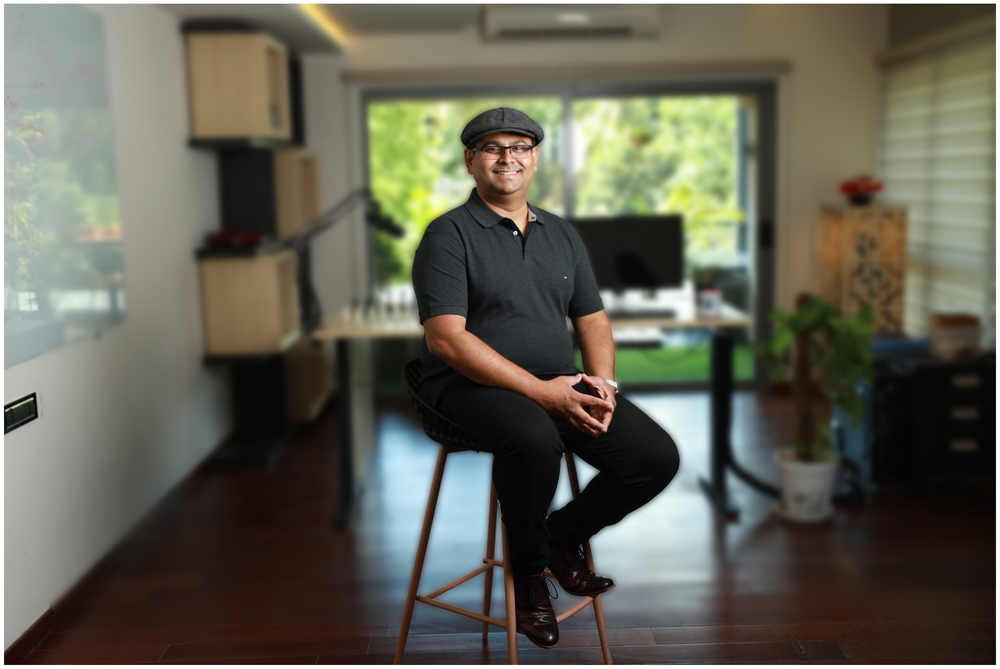

In [ ]:
output_file_path = "depth_blur_results/depth_blur_1.jpg"
depth_blur_opencv(rgb_image, raw_depth, kernel_size = (51, 51), sharp_focus_range = 0.22)

### Sample 2

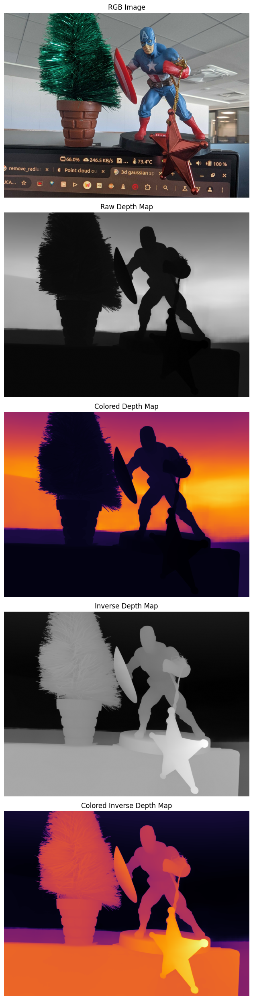

In [ ]:
image_path = "input_images/captain_america.jpg"
image_fname = os.path.splitext(os.path.basename(image_path))[0]
output_path = f"raw_depth_output/{image_fname}_raw_depth.png"

# Load RGB image and depth map
rgb_image = cv2.imread(image_path)[:, :, ::-1]  # Convert BGR to RGB
raw_depth = cv2.imread(output_path, cv2.IMREAD_GRAYSCALE)  # Load as grayscale depth map

raw_depth, inverse_depth = predict_depth(rgb_image, output_path)

plot(rgb_image, raw_depth, inverse_depth)

Focus range: 0 to 56


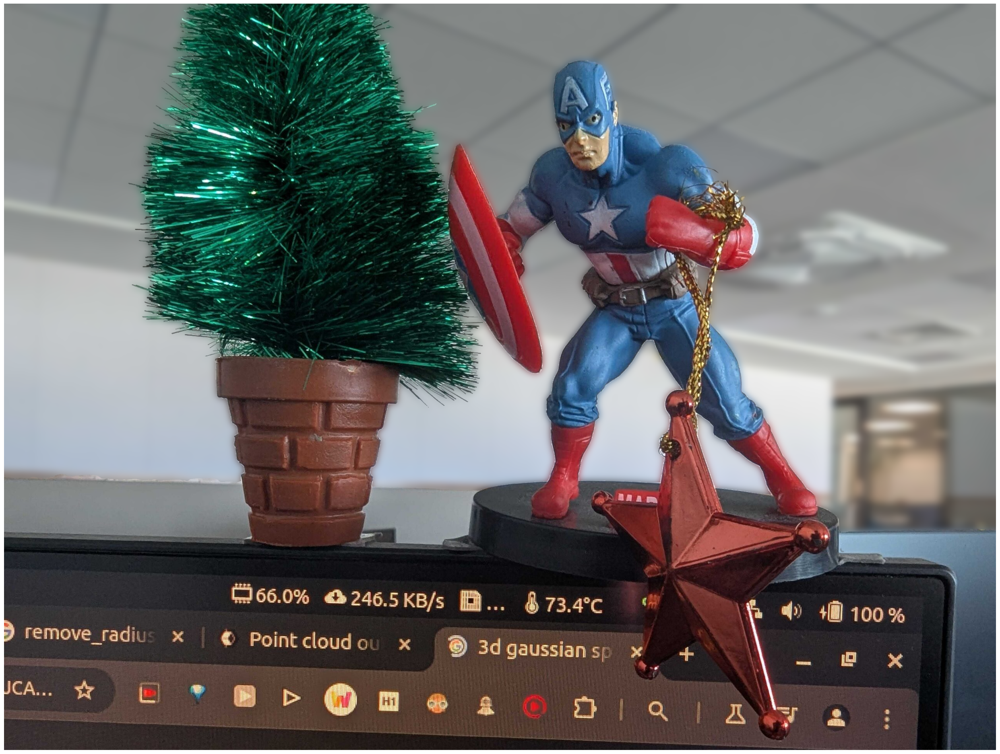

In [ ]:
output_file_path = "depth_blur_results/depth_blur_2.jpg"
depth_blur_opencv(rgb_image, raw_depth, kernel_size = (61, 61))

### Sample 3

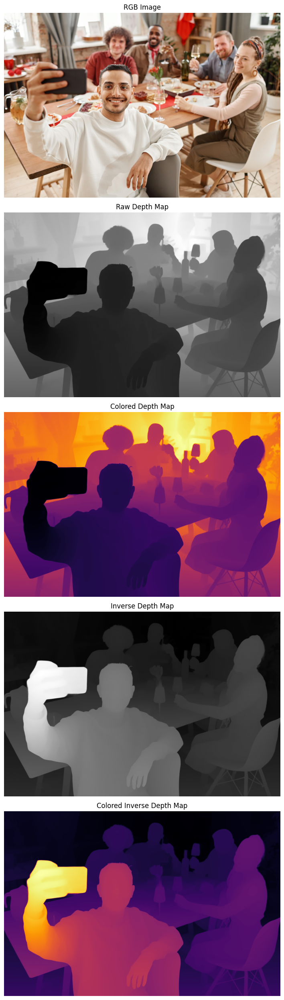

In [ ]:
image_path = "input_images/friends.jpg"
image_fname = os.path.splitext(os.path.basename(image_path))[0]
output_path = f"raw_depth_output/{image_fname}_raw_depth.png"

# Load RGB image and depth map
rgb_image = cv2.imread(image_path)[:, :, ::-1]  # Convert BGR to RGB
raw_depth = cv2.imread(output_path, cv2.IMREAD_GRAYSCALE)  # Load as grayscale depth map

raw_depth, inverse_depth = predict_depth(rgb_image, output_path)

plot(rgb_image, raw_depth, inverse_depth)

Focus range: 0 to 45


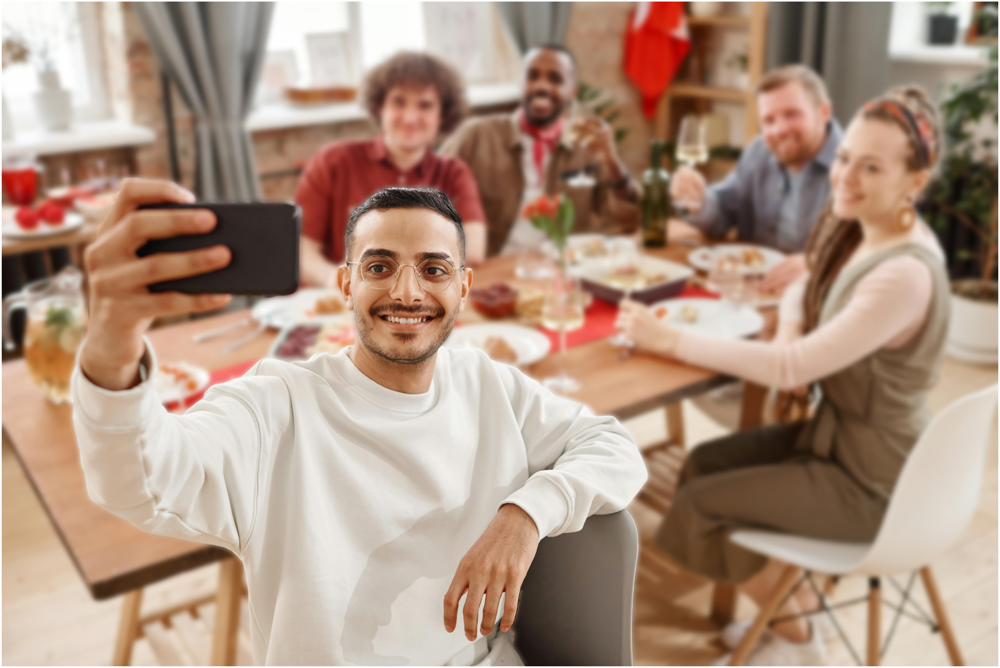

In [ ]:
output_file_path = "depth_blur_results/depth_blur_3.jpg"
depth_blur_opencv(rgb_image, raw_depth, kernel_size = (91, 91), sharp_focus_range = 0.18)

### Sample 4 : Focusing Far Region



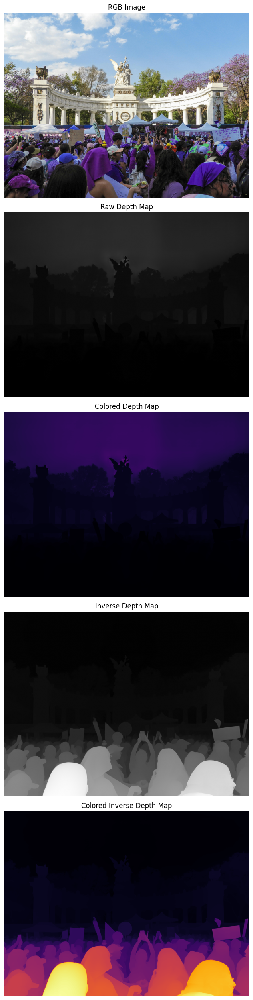

In [ ]:
image_path = "input_images/hemiciclo-a-jurez.jpg"
image_fname = os.path.splitext(os.path.basename(image_path))[0]
output_path = f"raw_depth_output/{image_fname}_raw_depth.png"

# Load RGB image and depth map
rgb_image = cv2.imread(image_path)[:, :, ::-1]  # Convert BGR to RGB
raw_depth = cv2.imread(output_path, cv2.IMREAD_GRAYSCALE)  # Load as grayscale depth map

raw_depth, inverse_depth = predict_depth(rgb_image, output_path)

plot(rgb_image, raw_depth, inverse_depth)

By default, **`focus_near` is set to the minimum depth value (0)**, meaning the focus starts at the **nearest object** in the scene. However, if you want to shift focus to a farther region, you can **manually adjust `manual_focus_near`** to start at a different depth value. This allows you to **control which part of the image stays sharp**, making it useful for emphasizing objects at specific distances.


In this particular scene, we want to focus on the **statue**, which is farther away than the **crowd in the foreground**. To achieve this, we can **defocus the crowd** by setting a custom starting point for focus using `manual_focus_near`. Instead of relying on the default behavior, which starts focusing on the **nearest objects**, specifying `manual_focus_near` allows us to **shift the focus to the distant statue**, keeping it sharp while blurring the foreground.  

Focus range: 8.5 to 56


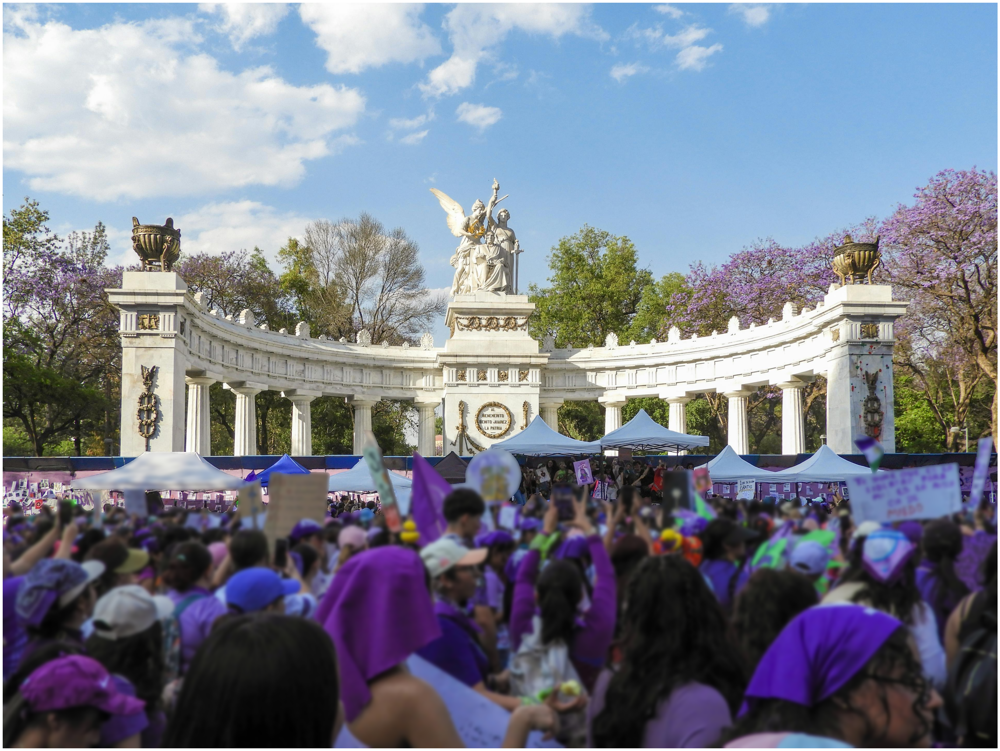

In [ ]:
output_file_path = "depth_blur_results/depth_blur_4.jpg"
depth_blur_opencv(rgb_image, raw_depth, kernel_size = (41, 41), sharp_focus_range = 0.22, manual_focus_near	=8.5)

## Conclusion  

This implementation provides a **basic depth-aware blur effect** using OpenCV and a predicted depth map. While it effectively simulates a portrait blur, the showcased examples are **cherry-picked cases** where depth estimation performs well. Results may vary depending on the image, scene complexity, and depth accuracy.  

To refine and customize the effect:  

- **Adjust the blur strength (`kernel_size`)** → Increase the kernel size for a stronger blur or reduce it for a more subtle effect.  
- **Test how well depth estimation adapts to different images** → Some scenes may produce better results than others based on texture and object separation.  
- **Use a different depth estimation method** → Experiment with stereo vision, real depth sensors, or alternative monocular models.  
- **Modify the sharp focus range (`sharp_focus_margin`)** → Increase it to expand the in-focus region or decrease it for a shallower depth of field effect.  
- **Manually set the focus depth (`manual_focus_near`)** → Override the automatic selection to focus on a specific depth level instead of relying on the inferred depth.  

Feel free to tweak these parameters and explore different techniques to achieve the best depth-based focus effect for your application!
